## Kaggle competition

##### Task
It's required to gather the data before create a model. Competition format is close to real life Data Scientists work: first of all EDA is required, then collect and aggregate a data, after that build a model. There are four types of data sources which could be interpreted as tables of database querries. Some data are aggregated and ready for simulation, but another requires to convert to suitable for modelling format.

Data description:

* train.csv - pairs "application - target values";
* test.csv - application data for prediction;
* bki.csv - data from Bureau of Credit History of clients;
* client_profile.csv - client profile data;
* payments.csv - payment history of client;
* applications_history.csv - historical data of previous client applications.

##### Stages of data analysis:
1. EDA for nulls and outliers correction;
2. Fill SCORING type features by simulated data; 
3. Combine client profile data for train and test;
4. Add statical features from historical data;
5. Add new features by comlumns combination;
6. Separate data to physical clients and companies;  
5. Tuning of hyperparameters by Optuna.

In [1]:
import kaggle
import optuna
import warnings
import numpy as np
import pandas as pd
import catboost as cb
import seaborn as sns
import matplotlib.pyplot as plt

from functools import reduce
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import train_test_split
from sklearn.inspection import permutation_importance

%matplotlib inline
%config InlineBackend.figure_format = 'svg'
# pd.options.display.max_columns = 250
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

In [2]:
# !chcp 65001
# !kaggle competitions download -c geekbrains-competitive-data-analysis

In [3]:
# !powershell -command "Expand-Archive -Force 'geekbrains-competitive-data-analysis.zip'"
# !del geekbrains-competitive-data-analysis.zip
# !dir

In [4]:
train = pd.read_csv('.\\train.csv', sep=',')
test = pd.read_csv('.\\test.csv', sep=',')
application_hist = pd.read_csv('.\\applications_history.csv', sep=',')
bki = pd.read_csv('.\\bki.csv', sep=',')
client_profile = pd.read_csv('.\\client_profile.csv', sep=',')
payments = pd.read_csv('.\\payments.csv', sep=',')
sample_submit = pd.read_csv('.\\sample_submit.csv', sep=',')

---
### 1. Exploration data analysis

In [5]:
sample_submit.sample(5)

,APPLICATION_NUMBER,TARGET
4603,123709754,0
53360,123642406,0
16186,123479213,0
138101,123459008,0
151872,123656485,0


In [6]:
train.head()

,APPLICATION_NUMBER,TARGET,NAME_CONTRACT_TYPE
0,123687442,0,Cash
1,123597908,1,Cash
2,123526683,0,Cash
3,123710391,1,Cash
4,123590329,1,Cash


In [7]:
client_profile.head()

,APPLICATION_NUMBER,GENDER,CHILDRENS,TOTAL_SALARY,AMOUNT_CREDIT,AMOUNT_ANNUITY,EDUCATION_LEVEL,FAMILY_STATUS,REGION_POPULATION,AGE,...,FAMILY_SIZE,EXTERNAL_SCORING_RATING_1,EXTERNAL_SCORING_RATING_2,EXTERNAL_SCORING_RATING_3,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,123666076,F,0,157500.0,270000.0,13500.0,Incomplete higher,Civil marriage,0.008068,8560,...,2.0,0.329471,0.236315,0.678568,0.0,0.0,0.0,0.0,1.0,2.0
1,123423688,F,0,270000.0,536917.5,28467.0,Secondary / secondary special,Married,0.020246,23187,...,2.0,NaN,0.442295,0.802745,0.0,0.0,0.0,0.0,1.0,1.0
2,123501780,M,1,427500.0,239850.0,23850.0,Incomplete higher,Married,0.072508,14387,...,3.0,0.409017,0.738159,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,123588799,M,0,112500.0,254700.0,17149.5,Secondary / secondary special,Married,0.019101,14273,...,2.0,NaN,0.308994,0.590233,0.0,0.0,0.0,0.0,0.0,3.0
4,123647485,M,0,130500.0,614574.0,19822.5,Lower secondary,Married,0.022625,22954,...,2.0,NaN,0.739408,0.156640,0.0,0.0,1.0,0.0,0.0,6.0


In [8]:
application_hist.head()

,PREV_APPLICATION_NUMBER,APPLICATION_NUMBER,NAME_CONTRACT_TYPE,AMOUNT_ANNUITY,AMT_APPLICATION,AMOUNT_CREDIT,AMOUNT_PAYMENT,AMOUNT_GOODS_PAYMENT,NAME_CONTRACT_STATUS,DAYS_DECISION,...,NAME_PRODUCT_TYPE,SELLERPLACE_AREA,CNT_PAYMENT,NAME_YIELD_GROUP,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,49298709,123595216,NaN,1730.430,17145.0,17145.0,0.0,17145.0,Approved,73,...,XNA,35,12.0,middle,365243.0,42.0,300.0,42.0,37.0,0.0
1,50070639,123431468,Cash,25188.615,607500.0,679671.0,NaN,607500.0,Approved,164,...,x-sell,-1,36.0,low_action,365243.0,134.0,916.0,365243.0,365243.0,1.0
2,49791680,123445379,Cash,15060.735,112500.0,136444.5,NaN,112500.0,Approved,301,...,x-sell,-1,12.0,high,365243.0,271.0,59.0,365243.0,365243.0,1.0
3,50087457,123499497,Cash,47041.335,450000.0,470790.0,NaN,450000.0,Approved,512,...,x-sell,-1,12.0,middle,365243.0,482.0,152.0,182.0,177.0,1.0
4,49052479,123525393,Cash,31924.395,337500.0,404055.0,NaN,337500.0,Refused,781,...,walk-in,-1,24.0,high,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
application_hist.drop(columns=['PREV_APPLICATION_NUMBER', 'APPLICATION_NUMBER']).describe(include='all')

,NAME_CONTRACT_TYPE,AMOUNT_ANNUITY,AMT_APPLICATION,AMOUNT_CREDIT,AMOUNT_PAYMENT,AMOUNT_GOODS_PAYMENT,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,...,NAME_PRODUCT_TYPE,SELLERPLACE_AREA,CNT_PAYMENT,NAME_YIELD_GROUP,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,940717,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1670214,1.670214e+06,1670214,1670214,...,1670214,1.670214e+06,1.297984e+06,1670214,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
unique,2,NaN,NaN,NaN,NaN,NaN,4,NaN,4,9,...,3,NaN,NaN,5,NaN,NaN,NaN,NaN,NaN,NaN
top,Cash,NaN,NaN,NaN,NaN,NaN,Approved,NaN,Cash through the bank,XAP,...,XNA,NaN,NaN,XNA,NaN,NaN,NaN,NaN,NaN,NaN
freq,747553,NaN,NaN,NaN,NaN,NaN,1036781,NaN,1033552,1353093,...,1063666,NaN,NaN,517215,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,NaN,8.806797e+02,NaN,NaN,...,NaN,3.139511e+02,1.605408e+01,NaN,342340.056543,15949.224065,35163.363265,78152.730207,83505.775017,0.332570
std,NaN,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,NaN,7.790997e+02,NaN,NaN,...,NaN,7.127443e+03,1.456729e+01,NaN,88413.495220,72007.270877,106405.950190,148833.342466,152484.418802,0.471134
min,NaN,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,NaN,1.000000e+00,NaN,NaN,...,NaN,-1.000000e+00,0.000000e+00,NaN,2.000000,2.000000,0.000000,2.000000,2.000000,0.000000
25%,NaN,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,NaN,2.800000e+02,NaN,NaN,...,NaN,-1.000000e+00,6.000000e+00,NaN,365243.000000,475.000000,257.000000,455.000000,447.000000,0.000000
50%,NaN,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,NaN,5.810000e+02,NaN,NaN,...,NaN,3.000000e+00,1.200000e+01,NaN,365243.000000,921.000000,741.000000,1155.000000,1171.000000,0.000000
75%,NaN,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,NaN,1.300000e+03,NaN,NaN,...,NaN,8.200000e+01,2.400000e+01,NaN,365243.000000,1825.000000,1735.000000,2418.000000,2501.000000,1.000000


In [10]:
application_hist.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 26 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   PREV_APPLICATION_NUMBER    1670214 non-null  int64  
 1   APPLICATION_NUMBER         1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE         940717 non-null   object 
 3   AMOUNT_ANNUITY             1297979 non-null  float64
 4   AMT_APPLICATION            1670214 non-null  float64
 5   AMOUNT_CREDIT              1670213 non-null  float64
 6   AMOUNT_PAYMENT             774370 non-null   float64
 7   AMOUNT_GOODS_PAYMENT       1284699 non-null  float64
 8   NAME_CONTRACT_STATUS       1670214 non-null  object 
 9   DAYS_DECISION              1670214 non-null  int64  
 10  NAME_PAYMENT_TYPE          1670214 non-null  object 
 11  CODE_REJECT_REASON         1670214 non-null  object 
 12  NAME_TYPE_SUITE            849809 non-null   object 
 13  NAME_CLIENT_

In [11]:
application_hist.groupby('APPLICATION_NUMBER')['SELLERPLACE_AREA'].value_counts()

APPLICATION_NUMBER  SELLERPLACE_AREA
123423340            23                 1
123423341            500                1
123423342           -1                  1
                     200                1
                     1400               1
                                       ..
123779594           -1                  3
                     20                 2
                     6                  1
                     50                 1
                     500                1
Name: SELLERPLACE_AREA, Length: 852844, dtype: int64

In [12]:
bki.head()

,APPLICATION_NUMBER,BUREAU_ID,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,123538884,5223613,Active,currency 1,718.0,0,377.0,NaN,19386.81,0,675000.00,320265.495,0.0,0.0,Consumer credit,39.0,NaN
1,123436670,6207544,Closed,currency 1,696.0,0,511.0,511.0,0.00,0,93111.66,0.000,0.0,0.0,Consumer credit,505.0,NaN
2,123589020,6326395,Closed,currency 1,165.0,0,149.0,160.0,NaN,0,36000.00,0.000,0.0,0.0,Consumer credit,150.0,0.0
3,123494590,6606618,Active,currency 1,55.0,0,310.0,NaN,NaN,0,38664.00,37858.500,NaN,0.0,Consumer credit,15.0,NaN
4,123446603,5046832,Active,currency 1,358.0,0,35.0,NaN,NaN,0,67500.00,0.000,0.0,0.0,Credit card,116.0,NaN


In [13]:
payments.head()

,PREV_APPLICATION_NUMBER,APPLICATION_NUMBER,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,49011181,123664960,1.0,5,1002.0,1015.0,12156.615,12156.615
1,48683432,123497205,1.0,13,442.0,432.0,18392.535,10047.645
2,48652024,123749925,1.0,10,8.0,23.0,5499.945,5499.945
3,48398897,123550846,0.0,82,398.0,398.0,7082.145,7082.145
4,49867197,123562174,0.0,63,1359.0,1359.0,156.735,156.735


In [14]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 110093 entries, 0 to 110092
Data columns (total 3 columns):
 #   Column              Non-Null Count   Dtype 
---  ------              --------------   ----- 
 0   APPLICATION_NUMBER  110093 non-null  int64 
 1   TARGET              110093 non-null  int64 
 2   NAME_CONTRACT_TYPE  110093 non-null  object
dtypes: int64(2), object(1)
memory usage: 2.5+ MB


In [15]:
train['TARGET'].value_counts()

0    101196
1      8897
Name: TARGET, dtype: int64

In [16]:
train.shape, client_profile.shape, application_hist.shape, bki.shape, payments.shape

((110093, 3), (250000, 24), (1670214, 26), (945234, 17), (1023932, 8))

In [17]:
train.columns, client_profile.columns, application_hist.columns, bki.columns, payments.columns

(Index(['APPLICATION_NUMBER', 'TARGET', 'NAME_CONTRACT_TYPE'], dtype='object'),
 Index(['APPLICATION_NUMBER', 'GENDER', 'CHILDRENS', 'TOTAL_SALARY',
        'AMOUNT_CREDIT', 'AMOUNT_ANNUITY', 'EDUCATION_LEVEL', 'FAMILY_STATUS',
        'REGION_POPULATION', 'AGE', 'DAYS_ON_LAST_JOB', 'OWN_CAR_AGE',
        'FLAG_PHONE', 'FLAG_EMAIL', 'FAMILY_SIZE', 'EXTERNAL_SCORING_RATING_1',
        'EXTERNAL_SCORING_RATING_2', 'EXTERNAL_SCORING_RATING_3',
        'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
        'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
        'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR'],
       dtype='object'),
 Index(['PREV_APPLICATION_NUMBER', 'APPLICATION_NUMBER', 'NAME_CONTRACT_TYPE',
        'AMOUNT_ANNUITY', 'AMT_APPLICATION', 'AMOUNT_CREDIT', 'AMOUNT_PAYMENT',
        'AMOUNT_GOODS_PAYMENT', 'NAME_CONTRACT_STATUS', 'DAYS_DECISION',
        'NAME_PAYMENT_TYPE', 'CODE_REJECT_REASON', 'NAME_TYPE_SUITE',
        'NAME_CLIENT_TYPE',

In [18]:
# Function for several dataframe merge (more than 2)
def frame_merger(data_frames: list,
                 on_columns: list=None,
                 how_merge: str='left',
                 left_on: str=None, 
                 right_on: str=None,
                 left_index: bool=False,
                 right_index: bool=False) -> pd.DataFrame:
    """
    Method for merge few Data Frames (more than 2)
    :data_frames: list of Data Frames
    :merge_on_columns: list of columns on merge
    :how_merge: str of merge type (left, right, outer, etc)
    """
    return reduce(lambda df1, df2: pd.merge(df1, df2, 
                                            on=on_columns, 
                                            how=how_merge,
                                            left_on=left_on,
                                            right_on=right_on,
                                            left_index=left_index,
                                            right_index=right_index,
                                           ), 
                  data_frames)

In [19]:
# Посмотрим бейзлайн с данными пользователей без истории
train_data = frame_merger([train, client_profile], on_columns='APPLICATION_NUMBER')
train_data.head()

,APPLICATION_NUMBER,TARGET,NAME_CONTRACT_TYPE,GENDER,CHILDRENS,TOTAL_SALARY,AMOUNT_CREDIT,AMOUNT_ANNUITY,EDUCATION_LEVEL,FAMILY_STATUS,...,FAMILY_SIZE,EXTERNAL_SCORING_RATING_1,EXTERNAL_SCORING_RATING_2,EXTERNAL_SCORING_RATING_3,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,123687442,0,Cash,M,1.0,157500.0,855000.0,25128.0,Secondary / secondary special,Married,...,3.0,0.700784,0.645914,0.716570,0.0,0.0,1.0,0.0,0.0,2.0
1,123597908,1,Cash,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,123526683,0,Cash,F,0.0,135000.0,1006920.0,42660.0,Higher education,Married,...,2.0,NaN,0.682149,0.267869,0.0,0.0,0.0,7.0,0.0,4.0
3,123710391,1,Cash,M,0.0,180000.0,518562.0,22972.5,Secondary / secondary special,Married,...,2.0,NaN,0.171299,0.170446,0.0,0.0,0.0,0.0,0.0,0.0
4,123590329,1,Cash,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [20]:
train_data.describe(include='all')

,APPLICATION_NUMBER,TARGET,NAME_CONTRACT_TYPE,GENDER,CHILDRENS,TOTAL_SALARY,AMOUNT_CREDIT,AMOUNT_ANNUITY,EDUCATION_LEVEL,FAMILY_STATUS,...,FAMILY_SIZE,EXTERNAL_SCORING_RATING_1,EXTERNAL_SCORING_RATING_2,EXTERNAL_SCORING_RATING_3,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,1.100930e+05,110093.000000,110093,89539,89539.000000,8.953900e+04,8.953900e+04,89534.000000,89539,89539,...,89538.000000,39091.000000,89345.000000,71808.000000,77480.000000,77480.000000,77480.000000,77480.000000,77480.000000,77480.000000
unique,NaN,NaN,2,3,NaN,NaN,NaN,NaN,5,6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,Cash,F,NaN,NaN,NaN,NaN,Secondary / secondary special,Married,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,99551,59077,NaN,NaN,NaN,NaN,63506,57236,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,1.235772e+08,0.080813,NaN,NaN,0.421034,1.683230e+05,5.997495e+05,27119.655449,NaN,NaN,...,2.157844,0.501400,0.513890,0.511020,0.006066,0.006776,0.034151,0.266585,0.265333,1.903601
std,8.880939e+04,0.272550,NaN,NaN,0.728803,9.962278e+04,4.031694e+05,14503.018565,NaN,NaN,...,0.915425,0.209929,0.191253,0.195153,0.083264,0.111512,0.206492,0.905296,0.614651,1.875062
min,1.234233e+08,0.000000,NaN,NaN,0.000000,2.565000e+04,4.500000e+04,1615.500000,NaN,NaN,...,1.000000,0.014691,0.000010,0.000527,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.235005e+08,0.000000,NaN,NaN,0.000000,1.125000e+05,2.700000e+05,16524.000000,NaN,NaN,...,2.000000,0.334582,0.391285,0.370650,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.235769e+08,0.000000,NaN,NaN,0.000000,1.485000e+05,5.177880e+05,24903.000000,NaN,NaN,...,2.000000,0.504836,0.565177,0.535276,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,1.236539e+08,0.000000,NaN,NaN,1.000000,2.025000e+05,8.086500e+05,34596.000000,NaN,NaN,...,3.000000,0.671532,0.663661,0.669057,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000


In [21]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110093 entries, 0 to 110092
Data columns (total 26 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   APPLICATION_NUMBER          110093 non-null  int64  
 1   TARGET                      110093 non-null  int64  
 2   NAME_CONTRACT_TYPE          110093 non-null  object 
 3   GENDER                      89539 non-null   object 
 4   CHILDRENS                   89539 non-null   float64
 5   TOTAL_SALARY                89539 non-null   float64
 6   AMOUNT_CREDIT               89539 non-null   float64
 7   AMOUNT_ANNUITY              89534 non-null   float64
 8   EDUCATION_LEVEL             89539 non-null   object 
 9   FAMILY_STATUS               89539 non-null   object 
 10  REGION_POPULATION           89539 non-null   float64
 11  AGE                         89539 non-null   float64
 12  DAYS_ON_LAST_JOB            89539 non-null   float64
 13  OWN_CAR_AGE   

In [22]:
# Analyse distribution of missing values
plt.figure(figsize=(14, 4))
plt.title('Missed values analysis', fontsize=20)
sns.set(font_scale=0.6)
sns.heatmap(train_data.sample(3000).isnull(), cmap=sns.color_palette(['blue', 'yellow']))
plt.show()

Lots of apllications have empty profile. It could be suggested that these profiles relates to Companies. Hence, it could be separated into two models: for physical clients and companies.

In [23]:
train_data.loc[train_data[['GENDER',
                           'CHILDRENS',
                           'TOTAL_SALARY',
                           'AMOUNT_CREDIT',
                           'AMOUNT_ANNUITY',
                           'EDUCATION_LEVEL',
                           'FAMILY_STATUS',
                           'REGION_POPULATION',
                           'AGE']].isnull().all(axis=1), "TARGET"].value_counts()

0    18865
1     1689
Name: TARGET, dtype: int64

There is TARGET as 0 as well as 1 in profile missing data.

In [24]:
numeric_cols = train_data.select_dtypes(include=[np.number]).columns
string_cols = train_data.select_dtypes(exclude=[np.number]).columns

Lets analyse distributions and boxplots of features

In [25]:
sns.set(style="ticks", color_codes=True)
rows_num = (len(numeric_cols) - 1) + np.int8(np.ceil(len(train_data.select_dtypes(exclude=[np.number]).columns) / 2))

fig, ax = plt.subplots(nrows=rows_num,ncols=2)
axes = ax.flatten()
i = 0

for col in numeric_cols:
    if col != 'APPLICATION_NUMBER':
        not_null_values = train_data.loc[~train_data[col].isna(), col]     
        axes[i].hist(not_null_values, density=True, log=True)
        axes[i].set_title(f'Histogram of {col}')
        i += 1

        axes[i].boxplot(not_null_values, vert=False, patch_artist=True)
        axes[i].set_title(f'Boxplot of {col}')
        i += 1
        
for col in string_cols:
    not_null_values = train_data.loc[~train_data[col].isna(), col]
    
    axes[i].hist(not_null_values, histtype='bar', bins=len(not_null_values.unique()))
    axes[i].set_xticklabels(not_null_values.unique(), rotation=20)
    axes[i].set_title(f'Histogram of {col}')
    i += 1
    
fig.set_size_inches(10, 3 * (len(numeric_cols) - 1 + len(string_cols)))
plt.subplots_adjust(wspace=0.3, hspace=0.5)

plt.show()

In [26]:
# The value NaN in OWN_CAR_AGE could means the abcence of car, so, make it 0
train_data['OWN_CAR_AGE'].fillna(value=0, inplace=True)

In [27]:
# The value 365243 (~1000 years) in DAYS_ON_LAST_JOB is quite high...
train_data.loc[train_data['DAYS_ON_LAST_JOB'] > 300000, 'DAYS_ON_LAST_JOB'] = train_data['DAYS_ON_LAST_JOB'].median()

In [28]:
# There are high values in REGION_POPULATION, it could be connected with multifloor houses, so let it 0.06
train_data.loc[train_data['REGION_POPULATION'] > 0.06, : ]

,APPLICATION_NUMBER,TARGET,NAME_CONTRACT_TYPE,GENDER,CHILDRENS,TOTAL_SALARY,AMOUNT_CREDIT,AMOUNT_ANNUITY,EDUCATION_LEVEL,FAMILY_STATUS,...,FAMILY_SIZE,EXTERNAL_SCORING_RATING_1,EXTERNAL_SCORING_RATING_2,EXTERNAL_SCORING_RATING_3,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
105,123722192,0,Cash,M,1.0,135000.0,284400.0,19134.0,Secondary / secondary special,Civil marriage,...,3.0,0.396665,0.134150,NaN,NaN,NaN,NaN,NaN,NaN,NaN
184,123622422,0,Cash,M,0.0,247500.0,545040.0,26509.5,Higher education,Civil marriage,...,2.0,NaN,0.730304,0.554947,0.0,0.0,0.0,0.0,0.0,8.0
286,123657462,0,Cash,M,1.0,135000.0,755190.0,38686.5,Secondary / secondary special,Married,...,3.0,NaN,0.435466,0.450747,0.0,0.0,0.0,0.0,0.0,1.0
363,123662257,0,Cash,F,2.0,157500.0,1260702.0,41665.5,Secondary / secondary special,Married,...,4.0,NaN,0.247934,0.793449,0.0,0.0,0.0,1.0,0.0,0.0
456,123532661,0,Cash,F,0.0,225000.0,269550.0,19300.5,Higher education,Married,...,2.0,NaN,0.607838,0.425893,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109900,123425402,0,Cash,M,1.0,225000.0,1046142.0,33876.0,Secondary / secondary special,Married,...,3.0,0.108370,0.753579,0.504681,0.0,0.0,0.0,0.0,0.0,1.0
110010,123560437,0,Cash,F,0.0,225000.0,715095.0,53464.5,Higher education,Single / not married,...,1.0,NaN,0.419839,0.000527,0.0,0.0,0.0,0.0,0.0,1.0
110028,123451770,0,Cash,F,1.0,112500.0,312768.0,22374.0,Incomplete higher,Married,...,3.0,NaN,0.539967,0.422370,0.0,0.0,0.0,0.0,0.0,0.0
110031,123728592,0,Cash,M,0.0,157500.0,463284.0,21726.0,Secondary / secondary special,Single / not married,...,1.0,0.167607,0.653176,NaN,0.0,0.0,0.0,0.0,0.0,1.0


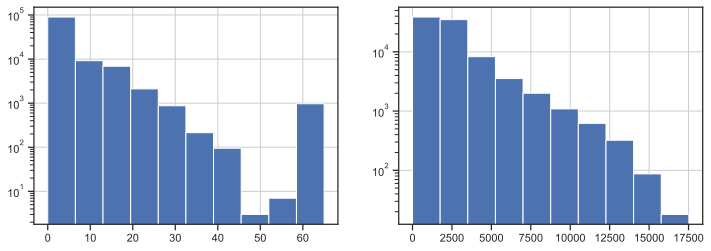

In [29]:
plt.figure(figsize=(12, 4))
plt.subplot(121)
train_data['OWN_CAR_AGE'].hist(log=True)
plt.subplot(122)
train_data['DAYS_ON_LAST_JOB'].hist(log=True)
plt.show()

---
Lets try to fill missed Scoring values from client profile by trained models, where its possible

In [30]:
train_data_not_null = train_data.dropna(subset=['GENDER',
                                                'CHILDRENS',
                                                'TOTAL_SALARY',
                                                'AMOUNT_CREDIT',
                                                'AMOUNT_ANNUITY',
                                                'EDUCATION_LEVEL',
                                                'FAMILY_STATUS',
                                                'REGION_POPULATION',
                                                'AGE'])
train_data_not_null.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 89534 entries, 0 to 110092
Data columns (total 26 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   APPLICATION_NUMBER          89534 non-null  int64  
 1   TARGET                      89534 non-null  int64  
 2   NAME_CONTRACT_TYPE          89534 non-null  object 
 3   GENDER                      89534 non-null  object 
 4   CHILDRENS                   89534 non-null  float64
 5   TOTAL_SALARY                89534 non-null  float64
 6   AMOUNT_CREDIT               89534 non-null  float64
 7   AMOUNT_ANNUITY              89534 non-null  float64
 8   EDUCATION_LEVEL             89534 non-null  object 
 9   FAMILY_STATUS               89534 non-null  object 
 10  REGION_POPULATION           89534 non-null  float64
 11  AGE                         89534 non-null  float64
 12  DAYS_ON_LAST_JOB            89534 non-null  float64
 13  OWN_CAR_AGE                 89

In [31]:
import catboost as cb

cb_params_r = {"n_estimators": 1000,
               "loss_function": "RMSE",
               "eval_metric": "R2",
               "max_bin": 20,
               "verbose": 200,
               "max_depth": 5,
               "l2_leaf_reg": 50,
               "early_stopping_rounds": 40,
               "thread_count": 5,
               "random_seed": 100,
              }

cb_model_r1 = cb.CatBoostRegressor(**cb_params_r)
cb_model_r2 = cb.CatBoostRegressor(**cb_params_r)
cb_model_r3 = cb.CatBoostRegressor(**cb_params_r)

In [32]:
def scoring_data_prepare(df: pd.DataFrame, scoring: str) -> cb.Pool:
    """
    Method prepare input data for scoring prediction
    :df: input DataFrame with data
    :scoring: scoring data for prepare
    """
    string_cols = df.select_dtypes(exclude=[np.number]).columns
    score_data = df.dropna(subset=[scoring])
    x = score_data.drop(columns=['APPLICATION_NUMBER',
                                 'TARGET',
                                 'EXTERNAL_SCORING_RATING_1',
                                 'EXTERNAL_SCORING_RATING_2',
                                 'EXTERNAL_SCORING_RATING_3',
                                ], 
                        errors='ignore')
    x[string_cols] = x[string_cols].astype('str')
    y = score_data[scoring]
    print(x.shape, y.shape)
    
    return cb.Pool(data=x, label=y, cat_features=string_cols.values)

def scoring_data_predict(df: pd.DataFrame, model: object, scoring: str) -> pd.DataFrame:
    """
    Method predict score data
    :df: input DataFrame with data
    :model: fitted model for prediction
    :scoring: scoring data for prediction
    """
    string_cols = df.select_dtypes(exclude=[np.number]).columns
    score_data = df.dropna(subset=[scoring])
    score_data_nan = pd.concat([df, score_data]).drop_duplicates(keep=False)
    x_nan = score_data_nan.drop(columns=['APPLICATION_NUMBER',
                                         'TARGET',
                                         'EXTERNAL_SCORING_RATING_1',
                                         'EXTERNAL_SCORING_RATING_2',
                                         'EXTERNAL_SCORING_RATING_3',
                                        ], 
                                errors='ignore')
    x_nan[string_cols] = x_nan[string_cols].astype('str')
    y_score = model.predict(x_nan)
    print(y_score.shape)
    
    return pd.DataFrame({'APPLICATION_NUMBER': score_data_nan['APPLICATION_NUMBER'], scoring: y_score})

In [33]:
pool_scoring_1 = scoring_data_prepare(train_data_not_null, 'EXTERNAL_SCORING_RATING_1')
cb_model_r1.fit(pool_scoring_1, eval_set=pool_scoring_1, plot=False)

(39087, 21) (39087,)
0:	learn: 0.0227679	test: 0.0227679	best: 0.0227679 (0)	total: 174ms	remaining: 2m 54s
200:	learn: 0.4675314	test: 0.4675256	best: 0.4675256 (200)	total: 7.5s	remaining: 29.8s
400:	learn: 0.4735065	test: 0.4734557	best: 0.4734557 (400)	total: 14.3s	remaining: 21.4s
600:	learn: 0.4771244	test: 0.4770472	best: 0.4770472 (600)	total: 21.4s	remaining: 14.2s
800:	learn: 0.4796113	test: 0.4795120	best: 0.4795120 (800)	total: 27.6s	remaining: 6.85s
999:	learn: 0.4819193	test: 0.4818004	best: 0.4818004 (999)	total: 34.3s	remaining: 0us

bestTest = 0.4818003547
bestIteration = 999



In [34]:
y_score_1 = scoring_data_predict(train_data_not_null, cb_model_r1, 'EXTERNAL_SCORING_RATING_1')

(50447,)


In [35]:
pool_scoring_2 = scoring_data_prepare(train_data_not_null, 'EXTERNAL_SCORING_RATING_2')
cb_model_r2.fit(pool_scoring_2, eval_set=pool_scoring_2, plot=False)

(89340, 21) (89340,)
0:	learn: 0.0048846	test: 0.0048846	best: 0.0048846 (0)	total: 55.3ms	remaining: 55.3s
200:	learn: 0.1370366	test: 0.1370237	best: 0.1370237 (200)	total: 10.5s	remaining: 41.8s
400:	learn: 0.1489124	test: 0.1488607	best: 0.1488607 (400)	total: 21.3s	remaining: 31.9s
600:	learn: 0.1543580	test: 0.1542346	best: 0.1542346 (600)	total: 30.4s	remaining: 20.2s
800:	learn: 0.1569460	test: 0.1567308	best: 0.1567308 (800)	total: 39.2s	remaining: 9.73s
999:	learn: 0.1590048	test: 0.1586849	best: 0.1586849 (999)	total: 47.1s	remaining: 0us

bestTest = 0.1586848835
bestIteration = 999



In [36]:
pool_scoring_3 = scoring_data_prepare(train_data_not_null, 'EXTERNAL_SCORING_RATING_3')
cb_model_r3.fit(pool_scoring_3, eval_set=pool_scoring_3, plot=False)

(71804, 21) (71804,)
0:	learn: 0.0028928	test: 0.0028928	best: 0.0028928 (0)	total: 49.8ms	remaining: 49.7s
200:	learn: 0.0846319	test: 0.0846331	best: 0.0846331 (200)	total: 8.69s	remaining: 34.5s
400:	learn: 0.0939349	test: 0.0939112	best: 0.0939112 (400)	total: 16.8s	remaining: 25.2s
600:	learn: 0.0999874	test: 0.0999096	best: 0.0999096 (600)	total: 24.8s	remaining: 16.5s
800:	learn: 0.1040889	test: 0.1039528	best: 0.1039528 (800)	total: 32.4s	remaining: 8.04s
999:	learn: 0.1067398	test: 0.1064817	best: 0.1064817 (999)	total: 39.4s	remaining: 0us

bestTest = 0.1064817228
bestIteration = 999



The model of EXTERNAL_SCORING_RATING_1 has an acceptable accuracy. The accuracy of EXTERNAL_SCORING_RATING_2 and EXTERNAL_SCORING_RATING_3 is very low, therefore, fill only EXTERNAL_SCORING_RATING_1

In [37]:
train_data_not_null['EXTERNAL_SCORING_RATING_1'].fillna(value=y_score_1['EXTERNAL_SCORING_RATING_1'], inplace=True)

In [38]:
train_data = frame_merger([train_data, y_score_1], on_columns='APPLICATION_NUMBER')

In [39]:
train_data['EXTERNAL_SCORING_RATING_1_x'].fillna(value=train_data['EXTERNAL_SCORING_RATING_1_y'], inplace=True)
train_data.drop(columns=['EXTERNAL_SCORING_RATING_1_y'], inplace=True)
train_data.rename(columns={'EXTERNAL_SCORING_RATING_1_x': 'EXTERNAL_SCORING_RATING_1'}, inplace=True)

In [40]:
train_data[['FLAG_PHONE', 'FLAG_EMAIL']] = train_data[['FLAG_PHONE', 'FLAG_EMAIL']].astype('object')
train_data_not_null[['FLAG_PHONE', 'FLAG_EMAIL']] = train_data_not_null[['FLAG_PHONE', 'FLAG_EMAIL']].astype('object')

In [41]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110093 entries, 0 to 110092
Data columns (total 26 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   APPLICATION_NUMBER          110093 non-null  int64  
 1   TARGET                      110093 non-null  int64  
 2   NAME_CONTRACT_TYPE          110093 non-null  object 
 3   GENDER                      89539 non-null   object 
 4   CHILDRENS                   89539 non-null   float64
 5   TOTAL_SALARY                89539 non-null   float64
 6   AMOUNT_CREDIT               89539 non-null   float64
 7   AMOUNT_ANNUITY              89534 non-null   float64
 8   EDUCATION_LEVEL             89539 non-null   object 
 9   FAMILY_STATUS               89539 non-null   object 
 10  REGION_POPULATION           89539 non-null   float64
 11  AGE                         89539 non-null   float64
 12  DAYS_ON_LAST_JOB            89539 non-null   float64
 13  OWN_CAR_AGE   

---
### 2. Baseline modeling

There are a lot of categorial features, so, CatBoost was used for simulation

In [42]:
cb_params = {"n_estimators": 1000,
             "loss_function": "Logloss",
             "eval_metric": "AUC",
             "max_bin": 20,
             "verbose": 50,
             "max_depth": 5,
             "l2_leaf_reg": 50,
             "early_stopping_rounds": 100,
             "thread_count": 5,
             "random_seed": 100,
             "scale_pos_weight": 9,
             "learning_rate": 0.1,
            }

In [43]:
numeric_cols = train_data.select_dtypes(include=[np.number]).columns
string_cols = train_data.select_dtypes(exclude=[np.number]).columns
train_data[string_cols] = train_data[string_cols].astype('str')
train_data_not_null[string_cols] = train_data_not_null[string_cols].astype('str')

In [44]:
X_train, X_valid = train_test_split(train_data, test_size=0.25, random_state=20)
X_train_not_null, X_valid_not_null = train_test_split(train_data_not_null, test_size=0.25, random_state=20)

In [45]:
x_train = X_train.drop(columns=['APPLICATION_NUMBER', 'TARGET'])
y_train = X_train['TARGET']

x_valid = X_valid.drop(columns=['APPLICATION_NUMBER', 'TARGET'])
y_valid = X_valid['TARGET']

In [46]:
p_train = cb.Pool(data=x_train, label=y_train, cat_features=string_cols.values)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=string_cols.values)

In [47]:
cb_model_baseline = cb.CatBoostClassifier(**cb_params)
cb_model_baseline.fit(p_train, eval_set=[p_train, p_valid], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.6781594	test1: 0.6626307	best: 0.6626307 (0)	total: 104ms	remaining: 1m 44s
50:	test: 0.7234437	test1: 0.7076108	best: 0.7076108 (50)	total: 4.67s	remaining: 1m 26s
100:	test: 0.7304534	test1: 0.7116289	best: 0.7118047 (99)	total: 8.65s	remaining: 1m 17s
150:	test: 0.7380209	test1: 0.7143592	best: 0.7143592 (150)	total: 13.4s	remaining: 1m 15s
200:	test: 0.7441517	test1: 0.7148196	best: 0.7148971 (183)	total: 17.3s	remaining: 1m 8s
250:	test: 0.7501479	test1: 0.7147460	best: 0.7152547 (214)	total: 21.5s	remaining: 1m 4s
300:	test: 0.7561371	test1: 0.7151966	best: 0.7155334 (294)	total: 25.9s	remaining: 1m
350:	test: 0.7622296	test1: 0.7150801	best: 0.7156994 (335)	total: 30.2s	remaining: 55.9s
400:	test: 0.7692779	test1: 0.7151789	best: 0.7156994 (335)	total: 35.3s	remaining: 52.8s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.7156993654
bestIteration = 335

Shrink model to first 336 iterations.


---
There is some overfitting due to overbalance. Lets analyse Baseline on test data.

In [80]:
test_data = frame_merger([test, client_profile], on_columns='APPLICATION_NUMBER')
test_data['OWN_CAR_AGE'].fillna(value=0, inplace=True)
test_data.loc[test_data['DAYS_ON_LAST_JOB'] > 300000, 'DAYS_ON_LAST_JOB'] = test_data['DAYS_ON_LAST_JOB'].median()

test_data_not_null = test_data.dropna(subset=['GENDER',
                                              'CHILDRENS',
                                              'TOTAL_SALARY',
                                              'AMOUNT_CREDIT',
                                              'AMOUNT_ANNUITY',
                                              'EDUCATION_LEVEL',
                                              'FAMILY_STATUS',
                                              'REGION_POPULATION',
                                              'AGE'])

y_test_score_1 = scoring_data_predict(test_data_not_null, cb_model_r1, 'EXTERNAL_SCORING_RATING_1')
test_data_not_null['EXTERNAL_SCORING_RATING_1'].fillna(value=y_test_score_1['EXTERNAL_SCORING_RATING_1'], inplace=True)
test_data = frame_merger([test_data, y_test_score_1], on_columns='APPLICATION_NUMBER')

test_data['EXTERNAL_SCORING_RATING_1_x'].fillna(value=test_data['EXTERNAL_SCORING_RATING_1_y'], inplace=True)
test_data.drop(columns=['EXTERNAL_SCORING_RATING_1_y'], inplace=True)
test_data.rename(columns={'EXTERNAL_SCORING_RATING_1_x': 'EXTERNAL_SCORING_RATING_1'}, inplace=True)

test_data[['FLAG_PHONE', 'FLAG_EMAIL']] = test_data[['FLAG_PHONE', 'FLAG_EMAIL']].astype('object')
test_data_not_null[['FLAG_PHONE', 'FLAG_EMAIL']] = test_data_not_null[['FLAG_PHONE', 'FLAG_EMAIL']].astype('object')
numeric_cols = test_data.select_dtypes(include=[np.number]).columns
string_cols = test_data.select_dtypes(exclude=[np.number]).columns
test_data[string_cols] = test_data[string_cols].astype('str')
test_data_not_null[string_cols] = test_data_not_null[string_cols].astype('str')

y_pred_baseline = cb_model_baseline.predict_proba(test_data.drop(columns='APPLICATION_NUMBER'))[:, 1]
result_baseline = pd.DataFrame(zip(test_data['APPLICATION_NUMBER'], y_pred_baseline), columns=['APPLICATION_NUMBER', 'TARGET'])
result_baseline.shape, result_baseline.columns

(75539,)


((165141, 2), Index(['APPLICATION_NUMBER', 'TARGET'], dtype='object'))

In [82]:
result_baseline.to_csv('.\\result_baseline.csv', index=False, encoding='utf-8')

In [83]:
!kaggle competitions submit -c geekbrains-competitive-data-analysis -f result_baseline.csv -m "Baseline prediction"

Successfully submitted to GeekBrains Competitive Data Analysis



  0%|          | 0.00/4.80M [00:00<?, ?B/s]
  0%|          | 8.00k/4.80M [00:00<05:52, 14.2kB/s]
  5%|4         | 224k/4.80M [00:03<01:04, 74.5kB/s] 
  7%|6         | 328k/4.80M [00:03<00:42, 111kB/s] 
  7%|7         | 368k/4.80M [00:03<00:39, 117kB/s]
  8%|8         | 408k/4.80M [00:03<00:37, 124kB/s]
  9%|9         | 448k/4.80M [00:04<00:35, 130kB/s]
 10%|9         | 480k/4.80M [00:04<00:34, 130kB/s]
 11%|#         | 520k/4.80M [00:04<00:32, 136kB/s]
 11%|#1        | 560k/4.80M [00:05<00:31, 142kB/s]
 12%|#2        | 600k/4.80M [00:05<00:30, 146kB/s]
 13%|#3        | 640k/4.80M [00:05<00:29, 150kB/s]
 14%|#3        | 680k/4.80M [00:05<00:28, 152kB/s]
 15%|#4        | 720k/4.80M [00:06<00:27, 154kB/s]
 15%|#5        | 760k/4.80M [00:06<00:27, 155kB/s]
 16%|#6        | 800k/4.80M [00:06<00:26, 156kB/s]
 17%|#7        | 840k/4.80M [00:06<00:26, 157kB/s]
 18%|#7        | 880k/4.80M [00:07<00:26, 158kB/s]
 19%|#8        | 920k/4.80M [00:07<00:25, 159kB/s]
 20%|#9        | 968k/4.80M [00:

---
### 3. Feature engineering

The baseline os 0.72 on public leaderboard. Lets add features generated from historical data.

In [51]:
def feature_generator(df: pd.DataFrame,
                      aggr_col: list,
                      group_col: str) -> pd.DataFrame:
    """
    Method return DataFrame with the aggregation of main statistics (min, median, max) of numeric columns
    and frequency (value counts) of values in string columns.
    
    :df: DataFrame for aggregation
    :aggr_col: list of aggregation columns
    :group_col: str value of grouped column
    """
    # DataFrame from features
    df_stats = pd.DataFrame()
    
    # Total amount of applications
    df_stats['TOTAL_APPLICATIONS'] = df[group_col].value_counts()
    
    # Separate numerical and categorial features
    numeric_cols = df[aggr_col].select_dtypes(include=[np.number]).columns
    string_cols = df[aggr_col].select_dtypes(exclude=[np.number]).columns
    
    # Calculate mean values for numerical features
    for num_col in numeric_cols:
        add_stats = df.groupby(group_col)[num_col].agg(mean='mean')
        df_stats = pd.merge(df_stats, 
                            add_stats.fillna(value=0).add_prefix(f'{num_col}_'), 
                            how='left', 
                            left_index=True,
                            right_index=True)
        
    # Combine pivot table with frequency encoding for categorial features
    for str_col in string_cols:    
        add_stats = df.groupby(group_col)[str_col].value_counts().reset_index(name='Counts')
        add_stats = pd.pivot_table(add_stats, values='Counts', index=group_col, columns=str_col, aggfunc=np.sum, fill_value=0)
        df_stats = pd.merge(df_stats, 
                            add_stats.add_prefix(f'{str_col}_'), 
                            how='left', 
                            left_index=True,
                            right_index=True)
        
    return df_stats

In [52]:
# correct the type on flag-feature
application_hist['NFLAG_INSURED_ON_APPROVAL'] = application_hist['NFLAG_INSURED_ON_APPROVAL'].astype('str')

# Select required columns and generate features
columns_list = application_hist.columns[2:]
application_hist_features = feature_generator(application_hist, aggr_col=columns_list, group_col='APPLICATION_NUMBER')
application_hist_features.rename(columns={'TOTAL_APPLICATIONS': 'TOTAL_APPLICATIONS_hist'}, inplace=True)

In [53]:
columns_list = bki.columns[2:]
bki_features = feature_generator(bki, aggr_col=columns_list, group_col='APPLICATION_NUMBER')
bki_features.rename(columns={'TOTAL_APPLICATIONS': 'TOTAL_APPLICATIONS_bki'}, inplace=True)

In [54]:
columns_list = payments.columns[2:]
payments_features = feature_generator(payments, aggr_col=columns_list, group_col='APPLICATION_NUMBER')
payments_features.rename(columns={'TOTAL_APPLICATIONS': 'TOTAL_APPLICATIONS_payments'}, inplace=True)

In [55]:
train_data.shape, application_hist_features.shape, bki_features.shape, payments_features.shape

((110093, 26), (338857, 88), (273131, 35), (264726, 7))

In [56]:
# Merge historical features with current applications
train_data_full = frame_merger([train_data, 
                                application_hist_features, 
                                bki_features,
                                payments_features], 
                                left_on='APPLICATION_NUMBER', right_index=True)
train_data_full

,APPLICATION_NUMBER,TARGET,NAME_CONTRACT_TYPE,GENDER,CHILDRENS,TOTAL_SALARY,AMOUNT_CREDIT,AMOUNT_ANNUITY,EDUCATION_LEVEL,FAMILY_STATUS,...,CREDIT_TYPE_Mortgage,CREDIT_TYPE_Real estate loan,CREDIT_TYPE_Unknown type of loan,TOTAL_APPLICATIONS_payments,NUM_INSTALMENT_VERSION_mean,NUM_INSTALMENT_NUMBER_mean,DAYS_INSTALMENT_mean,DAYS_ENTRY_PAYMENT_mean,AMT_INSTALMENT_mean,AMT_PAYMENT_mean
0,123687442,0,Cash,M,1.0,157500.0,855000.0,25128.0,Secondary / secondary special,Married,...,0.0,0.0,0.0,4.0,1.000000,5.750000,2653.000000,2659.0,6275.9250,3960.37125
1,123597908,1,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,...,0.0,0.0,0.0,1.0,1.000000,9.000000,450.000000,457.0,11349.9000,11349.90000
2,123526683,0,Cash,F,0.0,135000.0,1006920.0,42660.0,Higher education,Married,...,1.0,0.0,0.0,4.0,0.500000,10.000000,1917.250000,1917.5,20169.4725,20169.47250
3,123710391,1,Cash,M,0.0,180000.0,518562.0,22972.5,Secondary / secondary special,Married,...,0.0,0.0,0.0,1.0,1.000000,2.000000,1843.000000,1854.0,2450.1150,2450.11500
4,123590329,1,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,...,0.0,0.0,0.0,4.0,1.000000,3.750000,1218.500000,1233.5,10608.3900,10608.39000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110088,123458312,0,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,...,0.0,0.0,0.0,3.0,1.000000,6.000000,2296.000000,2309.0,4725.6300,4725.63000
110089,123672463,0,Cash,F,0.0,175500.0,269550.0,12618.0,Secondary / secondary special,Married,...,0.0,0.0,0.0,6.0,0.833333,5.833333,795.166667,789.5,6097.0125,6373.66500
110090,123723001,0,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,...,0.0,0.0,0.0,1.0,1.000000,4.000000,70.000000,83.0,4998.6450,4998.64500
110091,123554358,0,Cash,F,2.0,270000.0,1024740.0,49428.0,Incomplete higher,Married,...,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


---
Create new features from current columns

In [57]:
def create_client_profile_features(df: pd.DataFrame):
    """
    Client feature generator
    """
    df["RATIO_ANNUITY_TO_AGE"] = df["AMOUNT_ANNUITY"] / df["AGE"]
    df["RATIO_CREDIT_TO_AGE"] = df["AMOUNT_CREDIT"] / df["AGE"]
    df["RATIO_SALARY_TO_AGE"] = df["TOTAL_SALARY"] / df["AGE"]
    df["RATIO_AGE_TO_EXPERIENCE"] = df["AGE"] / df["DAYS_ON_LAST_JOB"]
    df["RATIO_SALARY_TO_REGION_POPULATION"] = df["TOTAL_SALARY"] * df["REGION_POPULATION"]
    df["RATIO_CAR_TO_EXPERIENCE"] = df["OWN_CAR_AGE"] / df["DAYS_ON_LAST_JOB"]
    df["RATIO_CAR_TO_AGE"] = df["OWN_CAR_AGE"] / df["AGE"]
    df["RATIO_SALARY_TO_EXPERIENCE"] = df["TOTAL_SALARY"] / df["DAYS_ON_LAST_JOB"]
    df["RATIO_CREDIT_TO_EXPERIENCE"] = df["AMOUNT_CREDIT"] / df["DAYS_ON_LAST_JOB"]
    df["RATIO_ANNUITY_TO_EXPERIENCE"] = df["AMOUNT_ANNUITY"] / df["DAYS_ON_LAST_JOB"]
    df["DIFF_SALARY_ANNUITY"] = df["TOTAL_SALARY"] - df["AMOUNT_ANNUITY"]
    df['RATIO_CREDIT_TO_ANNUITY'] = df['AMOUNT_CREDIT'] / df['AMOUNT_ANNUITY']
    df["RATIO_ANNUITY_TO_SALARY"] = df['AMOUNT_ANNUITY'] / df['TOTAL_SALARY']
    df['RATIO_CREDIT_TO_SALARY'] = df['AMOUNT_CREDIT'] / df['TOTAL_SALARY']
    df["DIFF_SALARY_ANNUITY_TO_CHILD"] = df["DIFF_SALARY_ANNUITY"] / (1 + df["CHILDRENS"])
    df["EXTERNAL_SCORING_PROD"] = df["EXTERNAL_SCORING_RATING_1"] * df["EXTERNAL_SCORING_RATING_2"] * df["EXTERNAL_SCORING_RATING_3"]   
    df["EXPECTED_TOTAL_LOSS_1"] = df["EXTERNAL_SCORING_RATING_1"] * df["AMOUNT_CREDIT"]
    df["EXPECTED_TOTAL_LOSS_2"] = df["EXTERNAL_SCORING_RATING_2"] * df["AMOUNT_CREDIT"]
    df["EXPECTED_TOTAL_LOSS_3"] = df["EXTERNAL_SCORING_RATING_3"] * df["AMOUNT_CREDIT"]
    df["EXPECTED_MONTHLY_LOSS_1"] = df["EXTERNAL_SCORING_RATING_1"] * df["AMOUNT_ANNUITY"]
    df["EXPECTED_MONTHLY_LOSS_2"] = df["EXTERNAL_SCORING_RATING_2"] * df["AMOUNT_ANNUITY"]
    df["EXPECTED_MONTHLY_LOSS_3"] = df["EXTERNAL_SCORING_RATING_3"] * df["AMOUNT_ANNUITY"]
    
    return df

In [58]:
train_data_full.info(max_cols=300)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110093 entries, 0 to 110092
Data columns (total 156 columns):
 #    Column                                                       Non-Null Count   Dtype  
---   ------                                                       --------------   -----  
 0    APPLICATION_NUMBER                                           110093 non-null  int64  
 1    TARGET                                                       110093 non-null  int64  
 2    NAME_CONTRACT_TYPE                                           110093 non-null  object 
 3    GENDER                                                       110093 non-null  object 
 4    CHILDRENS                                                    89539 non-null   float64
 5    TOTAL_SALARY                                                 89539 non-null   float64
 6    AMOUNT_CREDIT                                                89539 non-null   float64
 7    AMOUNT_ANNUITY                                        

In [59]:
train_data_full.iloc[:, 26:].fillna(value=0, inplace=True)

In [60]:
create_client_profile_features(train_data_full)

,APPLICATION_NUMBER,TARGET,NAME_CONTRACT_TYPE,GENDER,CHILDRENS,TOTAL_SALARY,AMOUNT_CREDIT,AMOUNT_ANNUITY,EDUCATION_LEVEL,FAMILY_STATUS,...,RATIO_ANNUITY_TO_SALARY,RATIO_CREDIT_TO_SALARY,DIFF_SALARY_ANNUITY_TO_CHILD,EXTERNAL_SCORING_PROD,EXPECTED_TOTAL_LOSS_1,EXPECTED_TOTAL_LOSS_2,EXPECTED_TOTAL_LOSS_3,EXPECTED_MONTHLY_LOSS_1,EXPECTED_MONTHLY_LOSS_2,EXPECTED_MONTHLY_LOSS_3
0,123687442,0,Cash,M,1.0,157500.0,855000.0,25128.0,Secondary / secondary special,Married,...,0.159543,5.428571,66186.0,0.324353,599170.547652,552256.266546,612667.559305,17609.307043,16230.521013,18005.977111
1,123597908,1,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,123526683,0,Cash,F,0.0,135000.0,1006920.0,42660.0,Higher education,Married,...,0.316000,7.458667,92340.0,0.140009,771526.041963,686869.876357,269722.588880,32687.106175,29100.493510,11427.288803
3,123710391,1,Cash,M,0.0,180000.0,518562.0,22972.5,Secondary / secondary special,Married,...,0.127625,2.880900,157027.5,0.019217,341311.766018,88829.188848,88386.882459,15120.245110,3935.167908,3915.573562
4,123590329,1,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110088,123458312,0,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
110089,123672463,0,Cash,F,0.0,175500.0,269550.0,12618.0,Secondary / secondary special,Married,...,0.071897,1.535897,162882.0,0.144872,142348.303154,127166.558499,156738.932900,6663.516562,5952.838565,7337.161400
110090,123723001,0,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
110091,123554358,0,Cash,F,2.0,270000.0,1024740.0,49428.0,Incomplete higher,Married,...,0.183067,3.795333,73524.0,0.237806,670001.539719,667338.205604,572324.081646,32317.305956,32188.840903,27605.865593


---
Estimate model accuracy with new features

In [61]:
numeric_cols = train_data_full.select_dtypes(include=[np.number]).columns
string_cols = train_data_full.select_dtypes(exclude=[np.number]).columns
train_data_full[string_cols] = train_data_full[string_cols].astype('str')

In [62]:
X_train_full, X_valid_full = train_test_split(train_data_full, test_size=0.25, random_state=20)

In [63]:
x_train = X_train_full.drop(columns=['APPLICATION_NUMBER', 'TARGET'])
y_train = X_train_full['TARGET']

x_valid = X_valid_full.drop(columns=['APPLICATION_NUMBER', 'TARGET'])
y_valid = X_valid_full['TARGET']

p_train = cb.Pool(data=x_train, label=y_train, cat_features=string_cols.values)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=string_cols.values)

In [64]:
cb_model_full = cb.CatBoostClassifier(**cb_params)
cb_model_full.fit(p_train, eval_set=[p_train, p_valid], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.6609483	test1: 0.6526306	best: 0.6526306 (0)	total: 152ms	remaining: 2m 31s
50:	test: 0.7250693	test1: 0.7110087	best: 0.7111941 (48)	total: 6.6s	remaining: 2m 2s
100:	test: 0.7361591	test1: 0.7143349	best: 0.7143349 (100)	total: 12.5s	remaining: 1m 51s
150:	test: 0.7515499	test1: 0.7149896	best: 0.7154542 (127)	total: 18.6s	remaining: 1m 44s
200:	test: 0.7657007	test1: 0.7145050	best: 0.7154542 (127)	total: 25.1s	remaining: 1m 39s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.715454173
bestIteration = 127

Shrink model to first 128 iterations.


---
Show the "standart" feature importance

In [65]:
def show_feature_importances(feature_names: np.array,
                             feature_importances: np.array,
                             ascending: bool=False) -> None:
    """
    Method plots feature importances
    """
    feature_importances = pd.DataFrame({'feature': feature_names, 'importance': feature_importances})
    feature_importances = feature_importances.sort_values('importance', ascending=ascending)
    
    plt.figure(figsize = (8, len(feature_importances) * 0.355))
    
    sns.set(style="ticks", color_codes=True, font_scale=0.65)
    ax = sns.barplot(feature_importances['importance'], feature_importances['feature'])
    for patch in ax.patches:
        ax.annotate(f'{np.around(patch.get_width(), 2)}', 
                    xy=(patch.get_width()*0.988, patch.get_y() + patch.get_height()/2),
                    xytext=(5, 0),
                    textcoords='offset points', 
                    ha="left", 
                    va="center")
    
    plt.xlabel('Importance')
    plt.ylabel('Features')
    plt.title('Importance of features')
    plt.show()

In [66]:
check_importance = pd.DataFrame(zip(x_train.columns, cb_model_full.get_feature_importance()), columns=['feature_name', 'importance'])

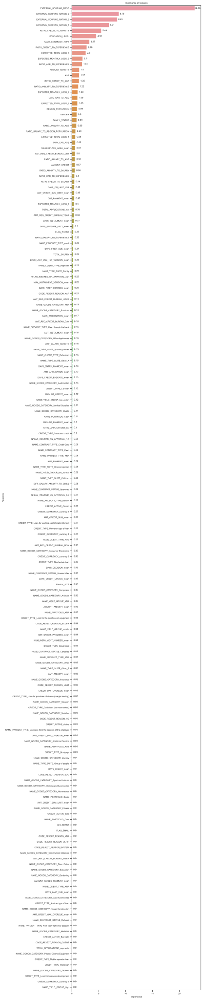

In [67]:
show_feature_importances(check_importance['feature_name'], check_importance['importance'])

---
Calculate permutation feature importance to estimate real weight of each feature

In [68]:
importance = permutation_importance(cb_model_full, x_valid, y_valid, scoring="roc_auc", n_jobs=-1, random_state=100)

In [69]:
importance_scores = pd.DataFrame({"features": x_valid.columns,
                                  "importance-mean": importance.importances_mean,
                                  "importance-std": importance.importances_std})
importance_scores = importance_scores.sort_values(by="importance-mean", ascending=False)
importance_scores = importance_scores.reset_index(drop=True)

In [70]:
importance_scores

,features,importance-mean,importance-std
0,EXTERNAL_SCORING_PROD,0.047523,0.002409
1,EXTERNAL_SCORING_RATING_2,0.017518,0.002906
2,EXTERNAL_SCORING_RATING_1,0.016442,0.001444
3,EXTERNAL_SCORING_RATING_3,0.013453,0.001357
4,NAME_CONTRACT_TYPE,0.007351,0.000200
...,...,...,...
171,NAME_PAYMENT_TYPE_Cash through the bank,-0.000206,0.000051
172,NAME_CONTRACT_STATUS_Approved,-0.000277,0.000178
173,EXPECTED_MONTHLY_LOSS_1,-0.000360,0.000140
174,NAME_TYPE_SUITE_Family,-0.000363,0.000117


---
Select the most important features and re-train model

In [71]:
best_features = importance_scores.loc[importance_scores['importance-mean'] > 1e-4, 'features'].values
best_features.shape

(48,)

In [72]:
x_train = X_train_full[best_features]
y_train = X_train_full['TARGET']

x_valid = X_valid_full[best_features]
y_valid = X_valid_full['TARGET']

p_train = cb.Pool(data=x_train, label=y_train, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=x_valid.select_dtypes(exclude=[np.number]).columns)

In [73]:
cb_model_full = cb.CatBoostClassifier(**cb_params)
cb_model_full.fit(p_train, eval_set=[p_train, p_valid], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.6685845	test1: 0.6650732	best: 0.6650732 (0)	total: 127ms	remaining: 2m 6s
50:	test: 0.7282287	test1: 0.7142826	best: 0.7142826 (50)	total: 5.29s	remaining: 1m 38s
100:	test: 0.7392555	test1: 0.7160069	best: 0.7161946 (99)	total: 10.4s	remaining: 1m 32s
150:	test: 0.7522123	test1: 0.7181573	best: 0.7182683 (147)	total: 15.5s	remaining: 1m 27s
200:	test: 0.7629490	test1: 0.7183773	best: 0.7191255 (162)	total: 19.9s	remaining: 1m 19s
250:	test: 0.7732675	test1: 0.7183621	best: 0.7191255 (162)	total: 25s	remaining: 1m 14s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.7191254954
bestIteration = 162

Shrink model to first 163 iterations.


---
Let's try separate data into physical client and company and train them seperately.

Model for physical clients.

In [74]:
train_data_phys = train_data_full.dropna(subset=['GENDER',
                                                 'CHILDRENS',
                                                 'TOTAL_SALARY',
                                                 'AMOUNT_CREDIT',
                                                 'AMOUNT_ANNUITY',
                                                 'EDUCATION_LEVEL',
                                                 'FAMILY_STATUS',
                                                 'REGION_POPULATION',
                                                 'AGE'])
train_data_phys.shape

(89534, 178)

In [75]:
train_data_comp = pd.concat([train_data_full, train_data_phys]).drop_duplicates(keep=False)
train_data_comp.drop(columns=client_profile.columns[1:], inplace=True)
train_data_comp.shape

(20559, 155)

In [84]:
X_phys_train, X_phys_valid = train_test_split(train_data_phys, test_size=0.25, random_state=20)
X_comp_train, X_comp_valid = train_test_split(train_data_comp, test_size=0.25, random_state=20)

In [85]:
x_train = X_phys_train.drop(columns=['APPLICATION_NUMBER', 'TARGET'])
y_train = X_phys_train['TARGET']

x_valid = X_phys_valid.drop(columns=['APPLICATION_NUMBER', 'TARGET'])
y_valid = X_phys_valid['TARGET']

p_train = cb.Pool(data=x_train, label=y_train, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)

In [86]:
cb_model_phys = cb.CatBoostClassifier(**cb_params)
cb_model_phys.fit(p_train, eval_set=[p_train, p_valid], plot=True)

Custom logger is already specified. Specify more than one logger at same time is not thread safe.

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.6963475	test1: 0.6949990	best: 0.6949990 (0)	total: 82.1ms	remaining: 1m 22s
50:	test: 0.7510777	test1: 0.7460751	best: 0.7460751 (50)	total: 3.7s	remaining: 1m 8s
100:	test: 0.7637084	test1: 0.7511005	best: 0.7511005 (100)	total: 7.14s	remaining: 1m 3s
150:	test: 0.7793731	test1: 0.7542547	best: 0.7542547 (150)	total: 10.6s	remaining: 59.3s
200:	test: 0.7939280	test1: 0.7549270	best: 0.7553998 (192)	total: 14s	remaining: 55.5s
250:	test: 0.8088156	test1: 0.7536560	best: 0.7553998 (192)	total: 17.4s	remaining: 51.9s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.7553998292
bestIteration = 192

Shrink model to first 193 iterations.


---
Select top features and re-train model for physical clients

In [87]:
importance_phys = permutation_importance(cb_model_phys, x_valid, y_valid, scoring="roc_auc", n_jobs=-1, random_state=100)

In [88]:
importance_scores_phys = pd.DataFrame({"features": x_valid.columns,
                                       "importance-mean": importance_phys.importances_mean,
                                       "importance-std": importance_phys.importances_std})
importance_scores_phys = importance_scores_phys.sort_values(by="importance-mean", ascending=False)
importance_scores_phys = importance_scores_phys.reset_index(drop=True)

In [89]:
importance_scores_phys

,features,importance-mean,importance-std
0,EXTERNAL_SCORING_PROD,0.049046,0.002068
1,EXTERNAL_SCORING_RATING_2,0.020612,0.001907
2,EXTERNAL_SCORING_RATING_3,0.018929,0.001133
3,EXTERNAL_SCORING_RATING_1,0.011987,0.001750
4,RATIO_CREDIT_TO_ANNUITY,0.010507,0.000734
...,...,...,...
171,DIFF_SALARY_ANNUITY,-0.000237,0.000129
172,AMT_PAYMENT_mean,-0.000260,0.000134
173,EXPECTED_MONTHLY_LOSS_1,-0.000297,0.000161
174,AMOUNT_ANNUITY_mean,-0.000298,0.000072


In [90]:
best_features_phys = importance_scores_phys.loc[importance_scores_phys['importance-mean'] > 1e-4, 'features'].values
best_features_phys.shape

(42,)

In [91]:
x_train = X_phys_train[best_features_phys]
y_train = X_phys_train['TARGET']

x_valid = X_phys_valid[best_features_phys]
y_valid = X_phys_valid['TARGET']

p_train = cb.Pool(data=x_train, label=y_train, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)

In [92]:
cb_model_phys = cb.CatBoostClassifier(**cb_params)
cb_model_phys.fit(p_train, eval_set=[p_train, p_valid], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.6841582	test1: 0.6872257	best: 0.6872257 (0)	total: 111ms	remaining: 1m 51s
50:	test: 0.7520118	test1: 0.7503497	best: 0.7503497 (50)	total: 4.39s	remaining: 1m 21s
100:	test: 0.7639161	test1: 0.7559634	best: 0.7559634 (100)	total: 8.13s	remaining: 1m 12s
150:	test: 0.7786022	test1: 0.7591295	best: 0.7591922 (145)	total: 11.7s	remaining: 1m 5s
200:	test: 0.7914839	test1: 0.7595104	best: 0.7595104 (200)	total: 15.5s	remaining: 1m 1s
250:	test: 0.8031381	test1: 0.7592571	best: 0.7598803 (234)	total: 19.2s	remaining: 57.4s
300:	test: 0.8133358	test1: 0.7586815	best: 0.7598803 (234)	total: 23.1s	remaining: 53.6s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.7598803213
bestIteration = 234

Shrink model to first 235 iterations.


---
Model for companies

In [93]:
x_train = X_comp_train.drop(columns=['APPLICATION_NUMBER', 'TARGET'])
y_train = X_comp_train['TARGET']

x_valid = X_comp_valid.drop(columns=['APPLICATION_NUMBER', 'TARGET'])
y_valid = X_comp_valid['TARGET']

p_train = cb.Pool(data=x_train, label=y_train, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)

In [94]:
cb_model_comp = cb.CatBoostClassifier(**cb_params)
cb_model_comp.fit(p_train, eval_set=[p_train, p_valid], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.5243928	test1: 0.5132973	best: 0.5132973 (0)	total: 12.5ms	remaining: 12.5s
50:	test: 0.6791400	test1: 0.5296893	best: 0.5352495 (11)	total: 713ms	remaining: 13.3s
100:	test: 0.7360579	test1: 0.5293676	best: 0.5352495 (11)	total: 1.42s	remaining: 12.6s
150:	test: 0.8256675	test1: 0.5173048	best: 0.5354839 (109)	total: 2.1s	remaining: 11.8s
200:	test: 0.8750645	test1: 0.5130760	best: 0.5354839 (109)	total: 2.8s	remaining: 11.1s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.5354838891
bestIteration = 109

Shrink model to first 110 iterations.


---
Select top features and re-train model for companies

In [95]:
importance_comp = permutation_importance(cb_model_comp, x_valid, y_valid, scoring="roc_auc", n_jobs=-1, random_state=100)

In [96]:
importance_scores_comp = pd.DataFrame({"features": x_valid.columns,
                                       "importance-mean": importance_comp.importances_mean,
                                       "importance-std": importance_comp.importances_std})
importance_scores_comp = importance_scores_comp.sort_values(by="importance-mean", ascending=False)
importance_scores_comp = importance_scores_comp.reset_index(drop=True)

In [97]:
importance_scores_comp

,features,importance-mean,importance-std
0,NAME_CONTRACT_TYPE,0.011125,0.004806
1,NFLAG_INSURED_ON_APPROVAL_nan,0.007821,0.002411
2,AMT_CREDIT_MAX_OVERDUE_mean,0.007397,0.002652
3,NFLAG_INSURED_ON_APPROVAL_0.0,0.006946,0.003487
4,NAME_PRODUCT_TYPE_walk-in,0.006563,0.003685
...,...,...,...
148,AMT_APPLICATION_mean,-0.003080,0.003245
149,DAYS_ENTRY_PAYMENT_mean,-0.003320,0.002242
150,DAYS_INSTALMENT_mean,-0.003849,0.001761
151,"NAME_TYPE_SUITE_Spouse, partner",-0.004418,0.002574


In [98]:
best_features_comp = importance_scores_comp.loc[importance_scores_comp['importance-mean'] > 1e-3, 'features'].values
best_features_comp.shape

(39,)

In [99]:
x_train = X_comp_train[best_features_comp]
y_train = X_comp_train['TARGET']

x_valid = X_comp_valid[best_features_comp]
y_valid = X_comp_valid['TARGET']

p_train = cb.Pool(data=x_train, label=y_train, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)

In [100]:
cb_model_comp = cb.CatBoostClassifier(**cb_params)
cb_model_comp.fit(p_train, eval_set=[p_train, p_valid], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.5202835	test1: 0.5253810	best: 0.5253810 (0)	total: 10.4ms	remaining: 10.4s
50:	test: 0.6786888	test1: 0.5546284	best: 0.5546284 (50)	total: 550ms	remaining: 10.2s
100:	test: 0.7385790	test1: 0.5546604	best: 0.5615523 (65)	total: 1.12s	remaining: 9.96s
150:	test: 0.8145377	test1: 0.5502506	best: 0.5615523 (65)	total: 1.68s	remaining: 9.47s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.5615522927
bestIteration = 65

Shrink model to first 66 iterations.


Model accuracy for companies is quite low...

---
### 4. Hyperparameter optimization
Optimize hyperparameters using Optuna for whole and separate models

In [101]:
def objective(trial):

    p_train = cb.Pool(data=x_train, label=y_train, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
    p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
     
    params = {"n_estimators": 1000,
             "loss_function": "Logloss",
             "eval_metric": "AUC",
             "early_stopping_rounds": 100,
             "verbose": 0,
             "random_seed": 100,
             "scale_pos_weight": 9,
             # Tunning
             "max_bin": trial.suggest_int("max_bin", 10, 40),
             "max_depth": trial.suggest_int("max_depth", 2, 8),
             "l2_leaf_reg": trial.suggest_int("l2_leaf_reg", 10, 100),
             "thread_count": trial.suggest_int("thread_count", 1, 10), 
             "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.1),
            }

    cb_model = cb.CatBoostClassifier(**params)

    cb_model.fit(p_train, eval_set=[p_train, p_valid], plot=False)

    return roc_auc_score(y_valid, cb_model.predict_proba(x_valid)[:, 1])

In [102]:
x_train = X_train_full[best_features]
y_train = X_train_full['TARGET']

x_valid = X_valid_full[best_features]
y_valid = X_valid_full['TARGET']

In [103]:
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=20)

[I 2021-06-19 14:21:50,791] A new study created in memory with name: no-name-f27761ec-afa0-474a-9aba-f03041652223
[I 2021-06-19 14:22:34,785] Trial 0 finished with value: 0.7153917448080945 and parameters: {'max_bin': 14, 'max_depth': 6, 'l2_leaf_reg': 23, 'thread_count': 5, 'learning_rate': 0.05782576381982444}. Best is trial 0 with value: 0.7153917448080945.
[I 2021-06-19 14:23:13,762] Trial 1 finished with value: 0.7190793354990803 and parameters: {'max_bin': 27, 'max_depth': 8, 'l2_leaf_reg': 67, 'thread_count': 9, 'learning_rate': 0.08634302961760751}. Best is trial 1 with value: 0.7190793354990803.
[I 2021-06-19 14:24:17,467] Trial 2 finished with value: 0.7190221088954415 and parameters: {'max_bin': 32, 'max_depth': 6, 'l2_leaf_reg': 33, 'thread_count': 10, 'learning_rate': 0.03832032292546407}. Best is trial 1 with value: 0.7190793354990803.
[I 2021-06-19 14:25:10,106] Trial 3 finished with value: 0.7158794315343266 and parameters: {'max_bin': 12, 'max_depth': 6, 'l2_leaf_reg':

In [104]:
print("Number of finished trials: {}".format(len(study.trials)))
print("Best trial:")
trial_full = study.best_trial
print("  Value: {}".format(trial_full.value))
print("  Params: ")
for key, value in trial_full.params.items():
    print("    {}: {}".format(key, value))

Number of finished trials: 20
Best trial:
  Value: 0.7206575035099839
  Params: 
    max_bin: 34
    max_depth: 4
    l2_leaf_reg: 99
    thread_count: 8
    learning_rate: 0.0602940868565039


In [105]:
x_train = X_phys_train[best_features_phys]
y_train = X_phys_train['TARGET']

x_valid = X_phys_valid[best_features_phys]
y_valid = X_phys_valid['TARGET']

In [106]:
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=20)

[I 2021-06-19 14:38:20,763] A new study created in memory with name: no-name-87ece661-4e3a-45de-ab2e-6f10a11e7db1
[I 2021-06-19 14:39:15,207] Trial 0 finished with value: 0.7573639714086021 and parameters: {'max_bin': 35, 'max_depth': 7, 'l2_leaf_reg': 19, 'thread_count': 1, 'learning_rate': 0.0902377908796822}. Best is trial 0 with value: 0.7573639714086021.
[I 2021-06-19 14:41:12,504] Trial 1 finished with value: 0.7584168401311715 and parameters: {'max_bin': 15, 'max_depth': 7, 'l2_leaf_reg': 69, 'thread_count': 1, 'learning_rate': 0.035151550482988535}. Best is trial 1 with value: 0.7584168401311715.
[I 2021-06-19 14:42:40,112] Trial 2 finished with value: 0.7394873574841718 and parameters: {'max_bin': 30, 'max_depth': 7, 'l2_leaf_reg': 89, 'thread_count': 9, 'learning_rate': 0.001211996446364598}. Best is trial 1 with value: 0.7584168401311715.
[I 2021-06-19 14:43:09,556] Trial 3 finished with value: 0.7611212681738677 and parameters: {'max_bin': 20, 'max_depth': 3, 'l2_leaf_reg':

In [107]:
print("Number of finished trials: {}".format(len(study.trials)))
print("Best trial:")
trial_phys = study.best_trial
print("  Value: {}".format(trial_phys.value))
print("  Params: ")
for key, value in trial_phys.params.items():
    print("    {}: {}".format(key, value))

Number of finished trials: 20
Best trial:
  Value: 0.762314851478827
  Params: 
    max_bin: 26
    max_depth: 3
    l2_leaf_reg: 83
    thread_count: 7
    learning_rate: 0.057902158549912576


In [108]:
x_train = X_comp_train[best_features_comp]
y_train = X_comp_train['TARGET']

x_valid = X_comp_valid[best_features_comp]
y_valid = X_comp_valid['TARGET']

In [109]:
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=30)

[I 2021-06-19 14:54:01,348] A new study created in memory with name: no-name-004abbee-2181-40d6-97b4-c94c22b50372
[I 2021-06-19 14:54:07,323] Trial 0 finished with value: 0.5573786495100594 and parameters: {'max_bin': 19, 'max_depth': 2, 'l2_leaf_reg': 58, 'thread_count': 10, 'learning_rate': 0.06337608643500735}. Best is trial 0 with value: 0.5573786495100594.
[I 2021-06-19 14:54:10,098] Trial 1 finished with value: 0.547026317564874 and parameters: {'max_bin': 23, 'max_depth': 8, 'l2_leaf_reg': 84, 'thread_count': 5, 'learning_rate': 0.055406301852993244}. Best is trial 0 with value: 0.5573786495100594.
[I 2021-06-19 14:54:11,405] Trial 2 finished with value: 0.5544500461012265 and parameters: {'max_bin': 24, 'max_depth': 4, 'l2_leaf_reg': 31, 'thread_count': 8, 'learning_rate': 0.08887142488585206}. Best is trial 0 with value: 0.5573786495100594.
[I 2021-06-19 14:54:12,379] Trial 3 finished with value: 0.5456167035680919 and parameters: {'max_bin': 26, 'max_depth': 2, 'l2_leaf_reg':

In [110]:
print("Number of finished trials: {}".format(len(study.trials)))
print("Best trial:")
trial_comp = study.best_trial
print("  Value: {}".format(trial_comp.value))
print("  Params: ")
for key, value in trial_comp.params.items():
    print("    {}: {}".format(key, value))

Number of finished trials: 30
Best trial:
  Value: 0.5709667560069591
  Params: 
    max_bin: 27
    max_depth: 3
    l2_leaf_reg: 27
    thread_count: 10
    learning_rate: 0.0785267459245274


In [111]:
cb_params = {"n_estimators": 1000,
             "loss_function": "Logloss",
             "eval_metric": "AUC",
             "early_stopping_rounds": 100,
             "verbose": 100,
             "random_seed": 100,
             "scale_pos_weight": 9,
            }

In [112]:
x_train = X_train_full[best_features]
y_train = X_train_full['TARGET']

x_valid = X_valid_full[best_features]
y_valid = X_valid_full['TARGET']

p_train = cb.Pool(data=x_train, label=y_train, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)

In [113]:
cb_params.update(trial_full.params)
cb_model_full = cb.CatBoostClassifier(**cb_params)
cb_model_full.fit(p_train, eval_set=[p_train, p_valid], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.6683462	test1: 0.6655750	best: 0.6655750 (0)	total: 81.1ms	remaining: 1m 21s
100:	test: 0.7257208	test1: 0.7136673	best: 0.7137971 (98)	total: 7.69s	remaining: 1m 8s
200:	test: 0.7362638	test1: 0.7174903	best: 0.7176556 (190)	total: 15.3s	remaining: 1m
300:	test: 0.7481785	test1: 0.7193824	best: 0.7193824 (300)	total: 23.2s	remaining: 53.9s
400:	test: 0.7562432	test1: 0.7197160	best: 0.7197801 (396)	total: 31.4s	remaining: 46.9s
500:	test: 0.7625422	test1: 0.7201066	best: 0.7201066 (500)	total: 38.8s	remaining: 38.7s
600:	test: 0.7689266	test1: 0.7202442	best: 0.7202529 (578)	total: 46.3s	remaining: 30.7s
700:	test: 0.7747094	test1: 0.7204755	best: 0.7206575 (663)	total: 53.6s	remaining: 22.9s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.7206575035
bestIteration = 663

Shrink model to first 664 iterations.


In [114]:
x_train = X_phys_train[best_features_phys]
y_train = X_phys_train['TARGET']

x_valid = X_phys_valid[best_features_phys]
y_valid = X_phys_valid['TARGET']

p_train = cb.Pool(data=x_train, label=y_train, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)

In [115]:
cb_params.update(trial_phys.params)
cb_model_phys = cb.CatBoostClassifier(**cb_params)
cb_model_phys.fit(p_train, eval_set=[p_train, p_valid], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.6842535	test1: 0.6865941	best: 0.6865941 (0)	total: 57.6ms	remaining: 57.5s
100:	test: 0.7433952	test1: 0.7456800	best: 0.7456800 (100)	total: 4.98s	remaining: 44.3s
200:	test: 0.7535029	test1: 0.7542440	best: 0.7542966 (199)	total: 9.6s	remaining: 38.2s
300:	test: 0.7629396	test1: 0.7584444	best: 0.7585002 (297)	total: 14.7s	remaining: 34.1s
400:	test: 0.7692653	test1: 0.7603264	best: 0.7603264 (400)	total: 19.4s	remaining: 29s
500:	test: 0.7751709	test1: 0.7613834	best: 0.7614200 (498)	total: 24.7s	remaining: 24.6s
600:	test: 0.7800570	test1: 0.7619321	best: 0.7619592 (593)	total: 29.7s	remaining: 19.7s
700:	test: 0.7843445	test1: 0.7621793	best: 0.7621793 (700)	total: 34.6s	remaining: 14.8s
800:	test: 0.7888426	test1: 0.7622329	best: 0.7623149 (754)	total: 39.6s	remaining: 9.85s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.7623148515
bestIteration = 754

Shrink model to first 755 iterations.


In [116]:
x_train = X_comp_train[best_features_comp]
y_train = X_comp_train['TARGET']

x_valid = X_comp_valid[best_features_comp]
y_valid = X_comp_valid['TARGET']

p_train = cb.Pool(data=x_train, label=y_train, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)
p_valid = cb.Pool(data=x_valid, label=y_valid, cat_features=x_train.select_dtypes(exclude=[np.number]).columns)

In [117]:
cb_params.update(trial_comp.params)
cb_model_comp = cb.CatBoostClassifier(**cb_params)
cb_model_comp.fit(p_train, eval_set=[p_train, p_valid], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	test: 0.5193523	test1: 0.5247896	best: 0.5247896 (0)	total: 15ms	remaining: 15s
100:	test: 0.6310113	test1: 0.5430689	best: 0.5442720 (96)	total: 1.5s	remaining: 13.4s
200:	test: 0.7163465	test1: 0.5644198	best: 0.5694559 (172)	total: 3.04s	remaining: 12.1s
300:	test: 0.7674797	test1: 0.5700056	best: 0.5709668 (232)	total: 4.57s	remaining: 10.6s
Stopped by overfitting detector  (100 iterations wait)

bestTest = 0.570966756
bestIteration = 232

Shrink model to first 233 iterations.


---
### 5. Test data preparing and prediction
Seven blocks below (up to the frame_merger()) are the same as was during baseline. They are repeated for convinient review.

In [118]:
test_data = frame_merger([test, client_profile], on_columns='APPLICATION_NUMBER')
test_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 165141 entries, 0 to 165140
Data columns (total 25 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   APPLICATION_NUMBER          165141 non-null  int64  
 1   NAME_CONTRACT_TYPE          165141 non-null  object 
 2   GENDER                      134176 non-null  object 
 3   CHILDRENS                   134176 non-null  float64
 4   TOTAL_SALARY                134176 non-null  float64
 5   AMOUNT_CREDIT               134176 non-null  float64
 6   AMOUNT_ANNUITY              134170 non-null  float64
 7   EDUCATION_LEVEL             134176 non-null  object 
 8   FAMILY_STATUS               134176 non-null  object 
 9   REGION_POPULATION           134176 non-null  float64
 10  AGE                         134176 non-null  float64
 11  DAYS_ON_LAST_JOB            134176 non-null  float64
 12  OWN_CAR_AGE                 45501 non-null   float64
 13  FLAG_PHONE    

In [119]:
test_data['OWN_CAR_AGE'].fillna(value=0, inplace=True)
test_data.loc[test_data['DAYS_ON_LAST_JOB'] > 300000, 'DAYS_ON_LAST_JOB'] = test_data['DAYS_ON_LAST_JOB'].median()

In [120]:
application_hist['NFLAG_INSURED_ON_APPROVAL'] = application_hist['NFLAG_INSURED_ON_APPROVAL'].astype('str')

columns_list = application_hist.columns[2:]
application_hist_features = feature_generator(application_hist, aggr_col=columns_list, group_col='APPLICATION_NUMBER')
application_hist_features.rename(columns={'TOTAL_APPLICATIONS': 'TOTAL_APPLICATIONS_hist'}, inplace=True)

columns_list = bki.columns[2:]
bki_features = feature_generator(bki, aggr_col=columns_list, group_col='APPLICATION_NUMBER')
bki_features.rename(columns={'TOTAL_APPLICATIONS': 'TOTAL_APPLICATIONS_bki'}, inplace=True)

columns_list = payments.columns[2:]
payments_features = feature_generator(payments, aggr_col=columns_list, group_col='APPLICATION_NUMBER')
payments_features.rename(columns={'TOTAL_APPLICATIONS': 'TOTAL_APPLICATIONS_payments'}, inplace=True)

In [121]:
test_data_not_null = test_data.dropna(subset=['GENDER',
                                              'CHILDRENS',
                                              'TOTAL_SALARY',
                                              'AMOUNT_CREDIT',
                                              'AMOUNT_ANNUITY',
                                              'EDUCATION_LEVEL',
                                              'FAMILY_STATUS',
                                              'REGION_POPULATION',
                                              'AGE'])

In [122]:
test_data[['FLAG_PHONE', 'FLAG_EMAIL']] = test_data[['FLAG_PHONE', 'FLAG_EMAIL']].astype('object')
test_data_not_null[['FLAG_PHONE', 'FLAG_EMAIL']] = test_data_not_null[['FLAG_PHONE', 'FLAG_EMAIL']].astype('object')
numeric_cols = test_data.select_dtypes(include=[np.number]).columns
string_cols = test_data.select_dtypes(exclude=[np.number]).columns
test_data[string_cols] = test_data[string_cols].astype('str')
test_data_not_null[string_cols] = test_data_not_null[string_cols].astype('str')

In [123]:
y_test_score_1 = scoring_data_predict(test_data_not_null, cb_model_r1, 'EXTERNAL_SCORING_RATING_1')
test_data_not_null['EXTERNAL_SCORING_RATING_1'].fillna(value=y_test_score_1['EXTERNAL_SCORING_RATING_1'], inplace=True)
test_data = frame_merger([test_data, y_test_score_1], on_columns='APPLICATION_NUMBER')

(75539,)


In [124]:
test_data['EXTERNAL_SCORING_RATING_1_x'].fillna(value=test_data['EXTERNAL_SCORING_RATING_1_y'], inplace=True)
test_data.drop(columns=['EXTERNAL_SCORING_RATING_1_y'], inplace=True)
test_data.rename(columns={'EXTERNAL_SCORING_RATING_1_x': 'EXTERNAL_SCORING_RATING_1'}, inplace=True)

In [125]:
test_data_full = frame_merger([test_data, 
                               application_hist_features, 
                               bki_features,
                               payments_features], 
                               left_on='APPLICATION_NUMBER', right_index=True)

In [126]:
create_client_profile_features(test_data_full)

,APPLICATION_NUMBER,NAME_CONTRACT_TYPE,GENDER,CHILDRENS,TOTAL_SALARY,AMOUNT_CREDIT,AMOUNT_ANNUITY,EDUCATION_LEVEL,FAMILY_STATUS,REGION_POPULATION,...,RATIO_ANNUITY_TO_SALARY,RATIO_CREDIT_TO_SALARY,DIFF_SALARY_ANNUITY_TO_CHILD,EXTERNAL_SCORING_PROD,EXPECTED_TOTAL_LOSS_1,EXPECTED_TOTAL_LOSS_2,EXPECTED_TOTAL_LOSS_3,EXPECTED_MONTHLY_LOSS_1,EXPECTED_MONTHLY_LOSS_2,EXPECTED_MONTHLY_LOSS_3
0,123724268,Cash,M,0.0,117000.0,1125000.0,32895.0,Secondary / secondary special,Married,0.028663,...,0.281154,9.615385,84105.0,NaN,510303.451579,706799.427892,NaN,14921.272924,20666.815272,NaN
1,123456549,Cash,F,2.0,81000.0,312768.0,17095.5,Secondary / secondary special,Married,0.019689,...,0.211056,3.861333,21301.5,0.035011,100482.163110,180830.265914,58953.494506,5492.226888,9883.951718,3222.322825
2,123428178,Credit Card,F,2.0,157500.0,450000.0,22500.0,Secondary / secondary special,Married,0.019101,...,0.142857,2.857143,45000.0,0.027790,214324.905165,68644.984320,172125.811865,10716.245258,3432.249216,8606.290593
3,123619984,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,123671104,Cash,F,1.0,90000.0,254700.0,24939.0,Higher education,Married,0.015221,...,0.277100,2.830000,32530.5,0.150937,183028.441193,128802.709015,105788.917802,17921.265390,12611.742286,10358.342446
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
165136,123487967,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
165137,123536402,Cash,M,0.0,135000.0,450000.0,16807.5,Secondary / secondary special,Single / not married,0.028663,...,0.124500,3.333333,118192.5,0.174830,220696.429370,299686.841680,240874.312713,8243.011637,11193.303537,8996.655580
165138,123718238,Cash,nan,NaN,NaN,NaN,NaN,nan,nan,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
165139,123631557,Cash,F,0.0,112500.0,350181.0,36769.5,Secondary / secondary special,Married,0.030755,...,0.326840,3.112720,75730.5,NaN,250327.186912,266619.257702,NaN,26284.708477,27995.398940,NaN


In [127]:
test_data_full.iloc[:, 26:].fillna(value=0, inplace=True)

In [128]:
numeric_cols = test_data_full.select_dtypes(include=[np.number]).columns
string_cols = test_data_full.select_dtypes(exclude=[np.number]).columns
test_data_full[string_cols] = test_data_full[string_cols].astype('str')

In [129]:
x_full = test_data_full[best_features]
string_cols = x_full.select_dtypes(exclude=[np.number]).columns
x_full[string_cols] = x_full[string_cols].astype('str')

y_pred_full = cb_model_full.predict_proba(x_full)[:, 1]

In [130]:
result_full = pd.DataFrame(zip(test_data_full['APPLICATION_NUMBER'], y_pred_full), columns=['APPLICATION_NUMBER', 'TARGET'])
result_full.shape, result_full.columns

((165141, 2), Index(['APPLICATION_NUMBER', 'TARGET'], dtype='object'))

In [131]:
result_full.to_csv('.\\result_full.csv', index=False, encoding='utf-8')

In [132]:
test_data_phys = test_data_full.dropna(subset=['GENDER',
                                               'CHILDRENS',
                                               'TOTAL_SALARY',
                                               'AMOUNT_CREDIT',
                                               'AMOUNT_ANNUITY',
                                               'EDUCATION_LEVEL',
                                               'FAMILY_STATUS',
                                               'REGION_POPULATION',
                                               'AGE'])
test_data_comp = pd.concat([test_data_full, test_data_phys]).drop_duplicates(keep=False)
test_data_comp.drop(columns=client_profile.columns[1:], inplace=True)
test_data_phys.shape, test_data_comp.shape

((134170, 177), (30971, 154))

In [133]:
x_phys = test_data_phys[best_features_phys]
string_cols = x_phys.select_dtypes(exclude=[np.number]).columns
x_phys[string_cols] = x_phys[string_cols].astype('str')

y_pred_phys = cb_model_phys.predict_proba(x_phys)[:, 1]

In [135]:
x_comp = test_data_comp[best_features_comp]
string_cols = x_comp.select_dtypes(exclude=[np.number]).columns
x_comp[string_cols] = x_comp[string_cols].astype('str')

y_pred_comp = cb_model_comp.predict_proba(x_comp)[:, 1]

In [137]:
result = pd.concat([pd.DataFrame(zip(test_data_phys['APPLICATION_NUMBER'], y_pred_phys), columns=['APPLICATION_NUMBER', 'TARGET']),
                    pd.DataFrame(zip(test_data_comp['APPLICATION_NUMBER'], y_pred_comp), columns=['APPLICATION_NUMBER', 'TARGET'])],
                   axis=0, ignore_index=True)
result.shape, result.columns

((165141, 2), Index(['APPLICATION_NUMBER', 'TARGET'], dtype='object'))

In [138]:
result.to_csv('.\\result_combined.csv', index=False, encoding='utf-8')

In [139]:
!kaggle competitions submit -c geekbrains-competitive-data-analysis -f result_full.csv -m "Prediction of whole model"
!kaggle competitions submit -c geekbrains-competitive-data-analysis -f result_combined.csv -m "Prediction of combined model"

Successfully submitted to GeekBrains Competitive Data Analysis



  0%|          | 0.00/4.79M [00:00<?, ?B/s]
  0%|          | 8.00k/4.79M [00:01<10:41, 7.81kB/s]
  4%|4         | 208k/4.79M [00:02<00:40, 118kB/s]  
 15%|#4        | 728k/4.79M [00:02<00:09, 450kB/s]
 19%|#9        | 936k/4.79M [00:02<00:07, 522kB/s]
 38%|###8      | 1.83M/4.79M [00:02<00:02, 1.22MB/s]
 49%|####8     | 2.33M/4.79M [00:03<00:01, 1.41MB/s]
 61%|######    | 2.91M/4.79M [00:03<00:01, 1.65MB/s]
 75%|#######5  | 3.59M/4.79M [00:03<00:00, 1.94MB/s]
 91%|#########1| 4.37M/4.79M [00:03<00:00, 2.26MB/s]
100%|##########| 4.79M/4.79M [00:06<00:00, 741kB/s] 


Successfully submitted to GeekBrains Competitive Data Analysis



  0%|          | 0.00/4.78M [00:00<?, ?B/s]
  0%|          | 8.00k/4.78M [00:00<06:08, 13.6kB/s]
  4%|4         | 216k/4.78M [00:01<00:32, 149kB/s]  
 15%|#5        | 736k/4.78M [00:01<00:07, 534kB/s]
 30%|##9       | 1.43M/4.78M [00:02<00:03, 1.06MB/s]
 60%|#####9    | 2.87M/4.78M [00:02<00:00, 2.21MB/s]
100%|##########| 4.78M/4.78M [00:04<00:00, 1.03MB/s]
